# Сборный проект-4 
# Text_and_Image_POC

**Идея PoC (Proof of Concept, Проверка концепции) проекта:**

Разработать демонстрационную версию сервиса поиска изображений по текстовым описаниям, \
которая будет использовать нейросетевые модели для оценки соответствия между текстом и изображением.


## Описание данных

Данные доступны по [ссылке](https://code.s3.yandex.net/datasets/dsplus_integrated_project_4.zip).

В файле `train_dataset.csv` находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `train_images` содержатся изображения для тренировки модели.

В файле `CrowdAnnotations.tsv` — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.
3. Доля людей, подтвердивших, что описание соответствует изображению.
4. Количество человек, подтвердивших, что описание соответствует изображению.
5. Количество человек, подтвердивших, что описание не соответствует изображению.

В файле `ExpertAnnotations.tsv` содержатся данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.

3, 4, 5 — оценки трёх экспертов.

Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.

В файле `test_queries.csv` находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `test_images` содержатся изображения для тестирования модели.

Наш датасет содержит экспертные и краудсорсинговые оценки соответствия текста и изображения.

В файле с экспертными мнениями для каждой пары изображение-текст имеются оценки от трёх специалистов. Для решения задачи вы должны эти оценки агрегировать — превратить в одну. Существует несколько способов агрегации оценок, самый простой — голосование большинства: за какую оценку проголосовала большая часть экспертов (в нашем случае 2 или 3), та оценка и ставится как итоговая. Поскольку число экспертов меньше числа классов, может случиться, что каждый эксперт поставит разные оценки, например: 1, 4, 2. В таком случае данную пару изображение-текст можно исключить из датасета.

Вы можете воспользоваться другим методом агрегации оценок или придумать свой.

В файле с краудсорсинговыми оценками информация расположена в таком порядке:

1. Доля исполнителей, подтвердивших, что текст **соответствует** картинке.
2. Количество исполнителей, подтвердивших, что текст **соответствует** картинке.
3. Количество исполнителей, подтвердивших, что текст **не соответствует** картинке.

После анализа экспертных и краудсорсинговых оценок выберите либо одну из них, либо объедините их в одну по какому-то критерию: например, оценка эксперта принимается с коэффициентом 0.6, а крауда — с коэффициентом 0.4.

Ваша модель должна возвращать на выходе вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1.

## План проекта

1. **Подготовка данных**:
   - **Сбор данных**:
     - Собрать пары текст-изображение из `train_dataset.csv`.
     - Убедиться, что данные покрывают разнообразные случаи.
   - **Очистка данных**:
     - Удалить данные, нарушающие юридические ограничения (например, изображения детей).
     - Проверить и удалить дубликаты и некачественные данные.

2. **Агрегация оценок**:
   - **Краудсорсинговые оценки**:
     - Рассчитать средние значения и долю подтверждающих соответствие текстов и изображений.
   - **Экспертные оценки**:
     - Агрегировать оценки экспертов, используя метод голосования большинства.
   - **Объединение оценок**:
     - Разработать метод обобщения краудсорсинговых и экспертных оценок, например, взвешенное среднее, где экспертные оценки имеют больший вес.

3. **Обучение моделей**:
   - **Сиамская нейросеть**:
     - Разработка архитектуры сети с двумя идентичными подсетями для текста и изображений.
     - Подготовка положительных и отрицательных пар для обучения.
     - Обучение модели с использованием контрастивной потери.

4. **Векторизация**:
   - **Сиамская нейросеть**:
     - Преобразование текстов и изображений в векторные представления.

5. **Тестирование моделей**:
   - **Эмбеддинги тестовых изображений**:
     - Преобразовать все изображения из папки `test_images` в векторные представления с использованием обученных моделей.
   - **Запросы из `test_queries`**:
     - Выбрать 10 случайных запросов.
     - Преобразовать тексты запросов в векторные представления.
   - **Поиск подходящих изображений**:
     - **Сиамская сеть**: Использовать текстовый вектор для нахождения наименьшего расстояния до векторов изображений.
6. **Сравнение моделей**:
   - **Визуальная оценка**:
     - Визуально сравнить результаты поиска изображений для каждого запроса.
   - **Количественная оценка**:
     - Оценить модели на основе метрики качества (MSE для регрессионных задач).
   - **Выбор лучшей модели**:
     - На основе визуальной и количественной оценки выбрать наиболее эффективную модель.

7. **ВЫВОДЫ**

## Подготовка данных

In [1]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

Костыль, чтоб не падало ядро при импорте торча. А все потому что, о, ужас, задублены где то в заднице либы для external импорта. В нормальных языках с этим проблем нет, поскольку есть приоритизация хранилищ для внешних библиотек и пакетов. Петухон настолько кривой в этом плане, что я просто не могу. Не, ну серьезно, я должен писать скрипты для кофигурации кернела для КАЖДОГО долбанного проекта? C#, Java, кресты, прости хоспади, умеют строить граф зависимостей с версиями внешних пакетов. Да, при компиляции. Ну а тут что? Я ставлю пакет, он тащит 5672 прямых зависимости, еще раза в три больше транзитивных, некоторые уже установлены, но весия не та, на контракты и обратную совместимость опять же всем чхать. Одни пакеты перезаписывают другие, по контрактам что нибудь перестает влезать, рантайм разваливается. А ты сидишь как дурак и вилкой выковыриваешь коллизии по зависимостям. Ладно, такое и в компилируемых языках бывает, только вот он откажется собираться, и не навернет весь рантайм(как инструмент запуска кода) глобально из-за неправильной версии пакета. Интерпретируемость? ну так сделали бы конфигурацию ядра при чтении импортов на предкомпиляции. Один фиг все гундят, мол собирай импорты в начале в одной ячейке, ну и чего бы не принудить к этому разрабов нотацией языка, чтобы сишники лишний раз ван Россума по матушке не вспоминали? А если нужно посреди рантайма добавить еще зависимость? ну сериализуешь состояние памяти процесса, переконфигурируешь кернел, восстанавливаешь состояние памяти. Медленно? Медленно, но для приколистов с GIL(да-да, привет только ссылочные типы) это не должно быть проблемой. Короче, ван Россум - черт, не, не так, ЧОРТ!, петухон - дно, интерпретируемые языки и динамическая типизация не должны были существовать за пределами повершела или баша, потому что скорее выйдешь в окно, чем комфортно напишешь на них что то сложнее hello world. Потому что каждый день будешь восклицать что то типа "Какого у вас пакеты не в том порядке разложены, вы их че, в киосках заряжаете?!"
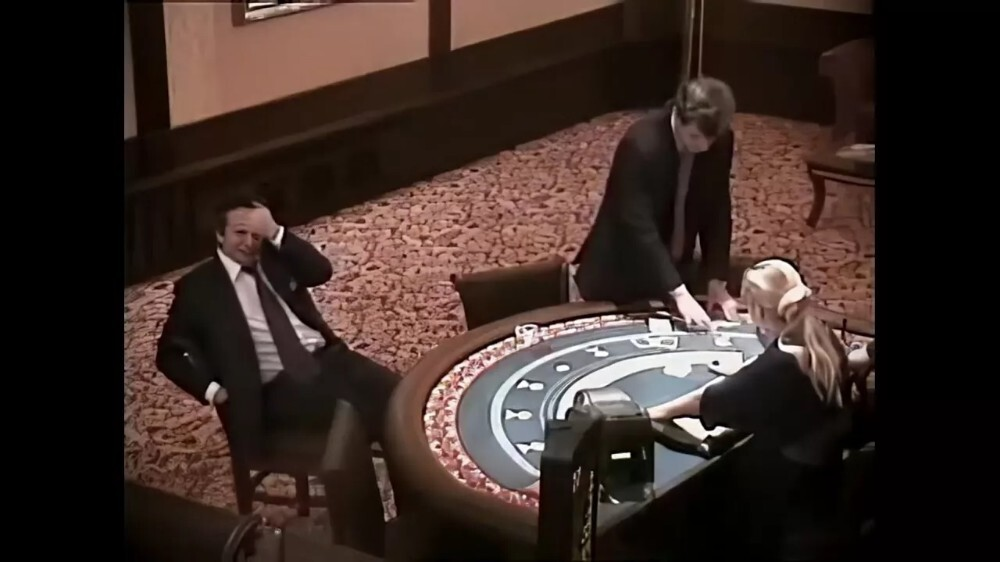

In [2]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random
import nltk
import re  # Необходимый импорт для работы с регулярными выражениями
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
from sklearn.model_selection import GroupShuffleSplit
from sklearn.metrics import mean_absolute_error
from transformers import DistilBertTokenizer, DistilBertModel
import clip
import inspect
from sklearn.preprocessing import MinMaxScaler

In [3]:
BASE_PATH = 'D:\\rep'
IMAGES_PATH = os.path.join(BASE_PATH, 'train_images')
IMAGES_PATH_TEST = os.path.join(BASE_PATH, 'test_images')

lemmatizer = WordNetLemmatizer()

stop_words = set(stopwords.words('english'))

keywords = [
    'child', 'children', 'kid', 'baby', 'toddler', 'infant', 'boy', 'girl', 'teen', 'teenager',
    'youth', 'juvenile', 'adolescent', 'young'
]
# Загрузка необходимых ресурсов
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ЕБЛАН\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\ЕБЛАН\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\ЕБЛАН\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [4]:
tag_dict = {"J": wordnet.ADJ,
            "N": wordnet.NOUN,
            "V": wordnet.VERB,
            "R": wordnet.ADV}

def GetWordnetPos(word):
    return tag_dict.get(nltk.pos_tag([word])[0][1][0].upper(), wordnet.NOUN)

def PreprocessText(text):
    text = re.sub(r'\d+', '', re.sub(r'[^\w\s]', '', text)).lower().strip().split()
    words = [lemmatizer.lemmatize(word, GetWordnetPos(word)) for word in text if word not in stop_words]
    return ' '.join(words)

In [5]:
crowd_annotations_columns = ['image', 'query_id', 'ratio', 'match_count', 'non_match_count']
expert_annotations_columns = ['image', 'query_id', 'expert_1', 'expert_2', 'expert_3']

train_dataset = pd.read_csv(os.path.join(BASE_PATH, 'train_dataset.csv'))

test_images = pd.read_csv(os.path.join(BASE_PATH, 'test_images.csv'))
crowd_annotations = pd.read_csv(os.path.join(BASE_PATH, 'CrowdAnnotations.tsv'), sep='\t', header=None, names=crowd_annotations_columns)
expert_annotations = pd.read_csv(os.path.join(BASE_PATH, 'ExpertAnnotations.tsv'), sep='\t', header=None, names=expert_annotations_columns)
test_queries = pd.read_csv(os.path.join(BASE_PATH, 'test_queries.csv'), sep="|", index_col=0)

In [6]:
def DescribeDataframe(df):
    df.info()
    display(df.describe())
    display(df.sample(2))
    print(f"\n Дубликатов в данных: {df.duplicated().sum()}")

In [7]:
print("Треировочные данные")
DescribeDataframe(train_dataset)
print()

print("Тестовые запросы")
DescribeDataframe(test_queries)
print()

print("Тестовые изображения")
DescribeDataframe(test_images)
print()

print("Оценка пользователей")
DescribeDataframe(crowd_annotations)
print()

print("Оценка экспертов")
DescribeDataframe(expert_annotations)
print()

Треировочные данные
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


,image,query_id,query_text
count,5822,5822,5822
unique,1000,977,977
top,3364151356_eecd07a23e.jpg,2600867924_cd502fc911.jpg#2,"Two dogs , one brown and white and one black a..."
freq,10,34,34


,image,query_id,query_text
4776,3009644534_992e9ea2a7.jpg,512101751_05a6d93e19.jpg#2,A white dog with a muzzle is running through a...
2021,246055693_ccb69ac5c6.jpg,1764955991_5e53a28c87.jpg#2,A dog with a ball in his mouth running down a ...



 Дубликатов в данных: 0

Тестовые запросы
<class 'pandas.core.frame.DataFrame'>
Index: 500 entries, 0 to 499
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    500 non-null    object
 1   query_text  500 non-null    object
 2   image       500 non-null    object
dtypes: object(3)
memory usage: 15.6+ KB


,query_id,query_text,image
count,500,500,500
unique,500,500,100
top,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
freq,1,1,5


,query_id,query_text,image
296,3351418768_596ef7fd6f.jpg#1,An Afican American woman standing behind two s...,3351418768_596ef7fd6f.jpg
105,2431120202_b24fe2333a.jpg#0,A girl cross-country skis .,2431120202_b24fe2333a.jpg



 Дубликатов в данных: 0

Тестовые изображения
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   100 non-null    object
dtypes: object(1)
memory usage: 932.0+ bytes


,image
count,100
unique,100
top,3356748019_2251399314.jpg
freq,1


,image
98,2670637584_d96efb8afa.jpg
18,123997871_6a9ca987b1.jpg



 Дубликатов в данных: 0

Оценка пользователей
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   image            47830 non-null  object 
 1   query_id         47830 non-null  object 
 2   ratio            47830 non-null  float64
 3   match_count      47830 non-null  int64  
 4   non_match_count  47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


,ratio,match_count,non_match_count
count,47830.000000,47830.000000,47830.000000
mean,0.068786,0.208488,2.820155
std,0.207532,0.628898,0.656676
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,3.000000
50%,0.000000,0.000000,3.000000
75%,0.000000,0.000000,3.000000
max,1.000000,5.000000,6.000000


,image,query_id,ratio,match_count,non_match_count
21215,293879742_5fe0ffd894.jpg,3256275785_9c3af57576.jpg#2,0.000000,0,3
30451,3299820401_c2589186c5.jpg,150387174_24825cf871.jpg#2,0.666667,2,1



 Дубликатов в данных: 0

Оценка экспертов
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   expert_1  5822 non-null   int64 
 3   expert_2  5822 non-null   int64 
 4   expert_3  5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.6+ KB


,expert_1,expert_2,expert_3
count,5822.000000,5822.000000,5822.000000
mean,1.436620,1.624356,1.881999
std,0.787084,0.856222,0.904087
min,1.000000,1.000000,1.000000
25%,1.000000,1.000000,1.000000
50%,1.000000,1.000000,2.000000
75%,2.000000,2.000000,2.000000
max,4.000000,4.000000,4.000000


,image,query_id,expert_1,expert_2,expert_3
5106,405615014_03be7ef618.jpg,2666205903_8d287669e1.jpg#2,1,1,2
4499,3544793763_b38546a5e8.jpg,3545586120_283d728a97.jpg#2,4,4,4



 Дубликатов в данных: 0



**Вывод:**

Данные были успешно загружены.\
В данных отсутвуют пропуски и дубликаты.\

## 1. Исследовательский анализ данных

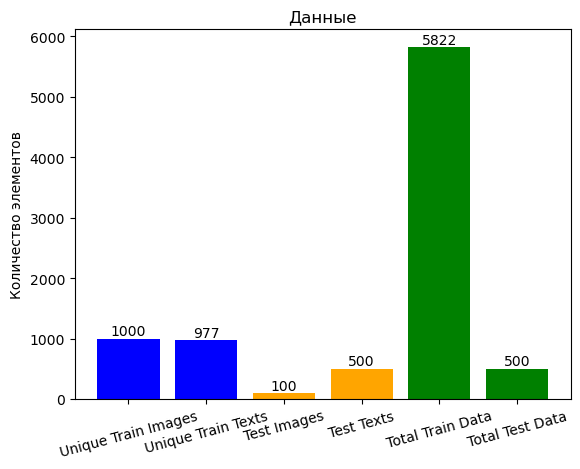

In [8]:
total_train_data = len(train_dataset)
total_test_data = len(test_queries)

labels = ['Unique Train Images', 'Unique Train Texts', 'Test Images', 'Test Texts', 'Total Train Data', 'Total Test Data']
counts = [train_dataset['image'].nunique(), train_dataset['query_text'].nunique(), test_images['image'].nunique(), test_queries['query_text'].nunique(), total_train_data, total_test_data]

fig, ax = plt.subplots()
bars = ax.bar(labels, counts, color=['blue', 'blue', 'orange', 'orange', 'green', 'green'])

for bar in bars:
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 5, int(yval), ha='center', va='bottom')

plt.xticks(rotation=15)
plt.ylabel('Количество элементов')
plt.title('Данные')
plt.show()

- **Обучающие данные**:
  - Количество уникальных изображений (1000) и текстовых запросов (977) примерно совпадает, что указывает на сбалансированность данных.
  - Общее количество записей (5822) значительно превышает количество уникальных элементов, что может свидетельствовать о наличии дублирующихся текстов или изображений с разными запросами.

- **Тестовые данные**:
  - Количество уникальных изображений (100) значительно меньше, чем количество уникальных текстовых запросов (500), что может указывать на наличие множества различных текстов для одного изображения.
  - Общее количество записей (500) совпадает с количеством уникальных текстовых запросов, что указывает на отсутствие дублирования текстов.

- **Общая картина**:
  - В тестовом наборе данных гораздо меньше уникальных изображений по сравнению с обучающим набором.
  - Обучающий набор данных содержит значительно больше данных, что указывает на необходимость достаточного объема данных для обучения модели.

### Идеальные соответсвия

`query_id` содержит в себе какой-то номер, например: \
`2587818583_4aa8e7b174.jpg#2`\
сопоставив его с id изображений, можно понять, что оно идеально копирует Id одного из фото.\
Проверим пары у которых идеально сопоставлены `query_id` с `image_id`. (соответсвие до #2)

А вообще кому в голову пришел такой формат хранения, а главное, зачем? ну чтобы что? ну типа он только путает, нормальные формы, не, не слышали? То есть вместо того, чтоб получить нормализованные данные и денормализовать их правильно для решения конкретной задачи(а так обычно и происходит), я занимаюсь какой то мутью. Абсолютно искусственное ненужное усложнение.

In [9]:
unique_texts_images = train_dataset.drop_duplicates(subset=['query_text'])

print(f"Количество уникальных записей (текстов и их соответствующих изображений): {len(unique_texts_images)}")

display(unique_texts_images.sample(5))

Количество уникальных записей (текстов и их соответствующих изображений): 977


,image,query_id,query_text
3540,2073105823_6dacade004.jpg,3353036763_4cbeba03b2.jpg#2,"two guy standing on horses , while a crowd wat..."
5232,2603792708_18a97bac97.jpg,2435685480_a79d42e564.jpg#2,A woman in a knit cap and green coat its on a ...
482,114051287_dd85625a04.jpg,3281078518_630a7a7f4f.jpg#2,Many white puppies are eating food near severa...
2088,1404832008_68e432665b.jpg,925491651_57df3a5b36.jpg#2,A tan dog jumps into water .
1793,138718600_f430ebca17.jpg,1317292658_ba29330a0b.jpg#2,A boy in swim trunks screams while being spray...


In [10]:
train_dataset['image_from_query_id'] = train_dataset['query_id'].apply(lambda x: x.split('#2')[0])

unique_query_ids = train_dataset['image_from_query_id'].unique()

perfect_matches = train_dataset[train_dataset['image'] == train_dataset['image_from_query_id']]
mismatches = train_dataset[train_dataset['image'] != train_dataset['image_from_query_id']]
num_matches = len(perfect_matches)
num_mismatches = len(mismatches)
print(f"Количество совпадающих пар: {num_matches}")
print(f"Количество несоответствующих пар: {num_mismatches}")
print("Пример совпадающих пар:")
display(perfect_matches.sample(3))

Количество совпадающих пар: 158
Количество несоответствующих пар: 5664
Пример совпадающих пар:


,image,query_id,query_text,image_from_query_id
981,2646046871_c3a5dbb971.jpg,2646046871_c3a5dbb971.jpg#2,A child in Hawaiian clothing jumps and poses i...,2646046871_c3a5dbb971.jpg
5106,2901880865_3fd7b66a45.jpg,2901880865_3fd7b66a45.jpg#2,A surfer is jumping a wave .,2901880865_3fd7b66a45.jpg
2126,533979933_a95b03323b.jpg,533979933_a95b03323b.jpg#2,A boy is on the beach with a paddle in his han...,533979933_a95b03323b.jpg


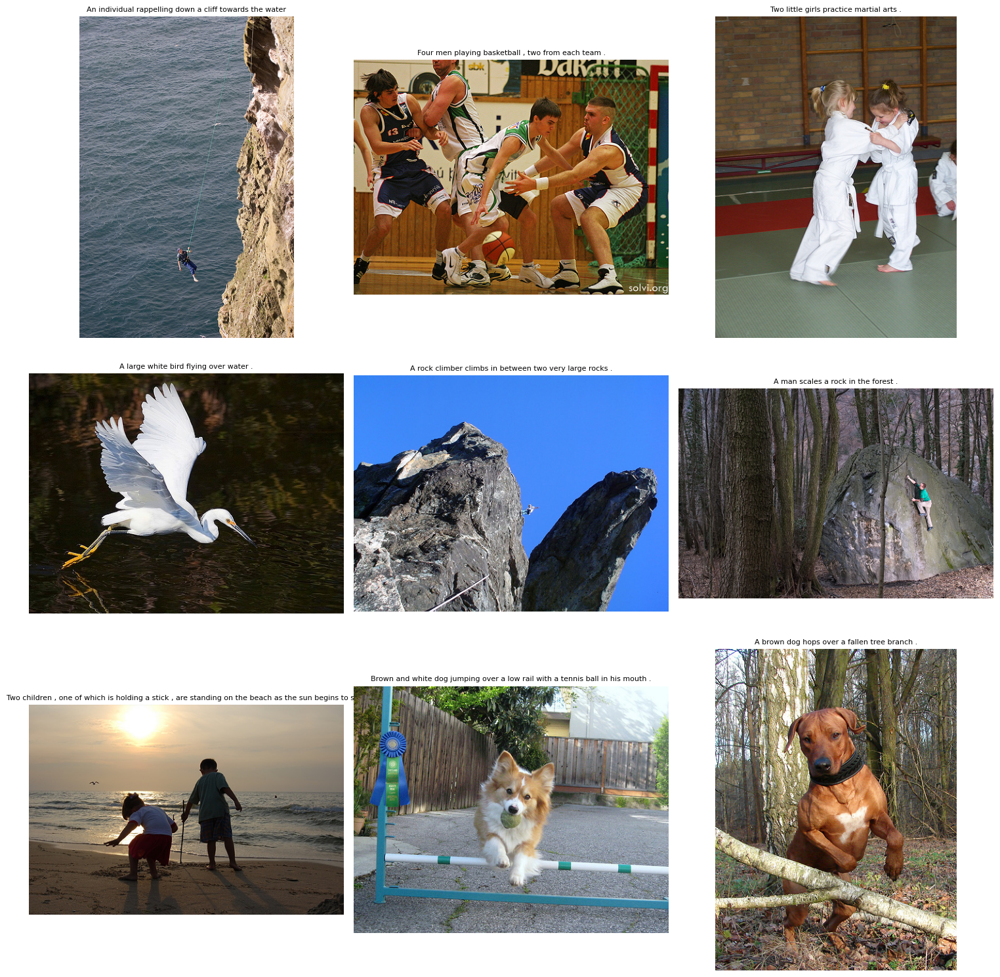

In [11]:
sampled_matches = perfect_matches.sample(9)

def display_image_and_description(ax, image_filename, description):
     image_path = os.path.join(IMAGES_PATH, image_filename)
     img = mpimg.imread(image_path)
     ax.imshow(img)
     ax.axis('off')
     ax.set_title(description, fontsize=8)

fig, axes = plt.subplots(3, 3, figsize=(15, 15))
for i, (idx, row) in enumerate(sampled_matches.iterrows()):
    ax = axes[i // 3, i % 3]
    display_image_and_description(ax, row['image'], row['query_text'])

plt.tight_layout()
plt.show()

**Вывод:**
* Из полученного вывода фотографий можно сказать, что соответсвие `id описания и id изображения` \
означает точное визуальное и смысловое соответсвие. 
* В дальнейшем, при составлении выборок для обучения модели или при агрегации общей оценки, \
зто знание можно использовать;
* **Количество совпадающих пар: 158** в наших данных говорят о том,\
что из 977 возможных идеальных соответсвий `фото + текст` в обучающих данных представлено только 155. \
А значит обучающую выборку можно будет дополнить.

### Анализ количества слов в тексте

In [12]:

def add_count_words(df, text_column): 
    df['word_count'] = df[text_column].apply(lambda x : len(x.split()))

add_count_words(train_dataset, 'query_text')
add_count_words(test_queries, 'query_text')

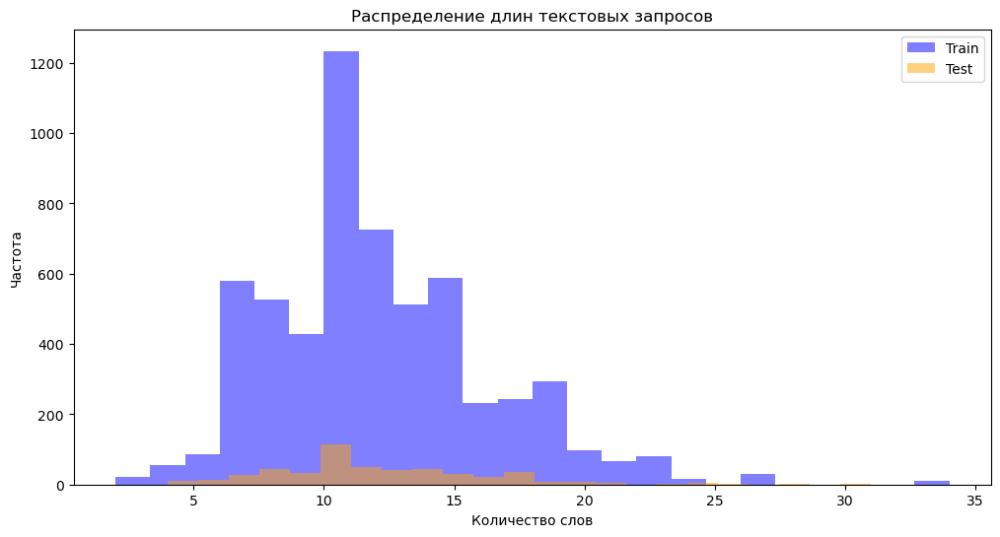

In [13]:

plt.figure(figsize=(12, 6))
plt.hist(train_dataset['word_count'].values, bins=24, alpha=0.5, label='Train', color='blue')
plt.hist(test_queries['word_count'].values, bins=23, alpha=0.5, label='Test', color='orange')
plt.xlabel('Количество слов')
plt.ylabel('Частота')
plt.legend(loc='upper right')
plt.title('Распределение длин текстовых запросов')
plt.show()

**Вывод:**

- **Сходство распределений**:
  - Распределения длин текстовых запросов в обучающем и тестовом наборах данных схожи, что может указывать на консистентность и однотипность данных в обоих наборах.
  - Оба набора данных имеют пики в районе 10 слов, что указывает на часто встречающуюся длину текстов в запросах.

- **Разнообразие длины запросов**:
  - Обучающий набор данных имеет большее разнообразие длины текстовых запросов, что может способствовать более универсальному обучению модели.
  - Тестовый набор данных имеет меньше текстов, но сохраняет схожее распределение, что может способствовать адекватной проверке модели.
  - Вообще, стоит ограничить контекстное окно, скажем, 256 словами. Все LLM имеют конечный контекст, описание > 256, кмк, нецелессобразно

### Анализ оценок

В нашем проекте подразумевается создание модели, которая предсказывает общую оценку соответсвия фото и текста.\
То есть, модель должна понимать меру соответсвия фото и описания основанную на шкале оценки: \
Чем выше оценка от (судей  и пользователей) у какой-либо пары `описание + фото`, \
тем выше вероятнось, что `описание + фото` соответсвют друг другу.

Таким образом, исследовательский анализ разметки от пользователей и экспертов должен повысить качество данных для обучения. \
Если удасться сохранить равновесие в границах соответсвия текста и изображения на основе анализа и выделить оптимальную систему оценки соответсвия, \
то модель будет иметь лучшие обощаемые свойства, да и метрики должны быть выше.

#### Пользовательская оценка

,ratio,match_count,non_match_count
count,47830.000000,47830.000000,47830.000000
mean,0.068786,0.208488,2.820155
std,0.207532,0.628898,0.656676
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,3.000000
50%,0.000000,0.000000,3.000000
75%,0.000000,0.000000,3.000000
max,1.000000,5.000000,6.000000


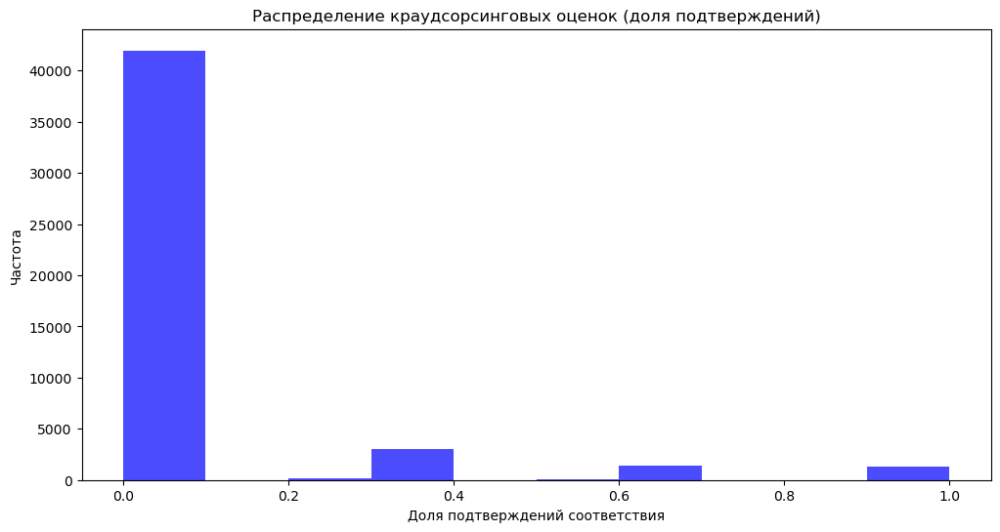

In [14]:
display(crowd_annotations.describe())
plt.figure(figsize=(12, 6))
plt.hist(crowd_annotations['ratio'], bins=10, alpha=0.7, color='blue')
plt.xlabel('Доля подтверждений соответствия')
plt.ylabel('Частота')
plt.title('Распределение краудсорсинговых оценок (доля подтверждений)')
plt.show()

**ВЫВОД:**

1. **Гистограмма распределения**:
   - Большинство оценок пользователей находятся в диапазоне 0.0, что означает,\
    что большинство пар текст-изображение не подтверждаются как соответствующие.
   - Небольшое количество оценок распределено в диапазонах 0.2, 0.6 и 1.0, \
   что указывает на малое количество подтвержденных соответствий.

2. **Статистическое описание**:
   - Среднее значение `match_ratio` составляет 0.0688, что также подтверждает, \
   что большинство пар имеют низкую долю подтверждений.
   - Минимальное значение `match_ratio` составляет 0.0, а максимальное 1.0, \
   что означает, что есть пары, которые либо не имеют подтверждений вообще,\
   либо подтверждаются полностью.
   - Значения 25-го, 50-го и 75-го процентилей равны 0.0, \
   что указывает на значительное смещение распределения в сторону низких долей подтверждений.
   - Стандартное отклонение `match_ratio` равно 0.2075,\
    что говорит о высокой концентрации оценок около нуля.


**Наблюдения**

  - Большая часть краудсорсинговых оценок равна 0.0, что указывает на то, \
  что большинство пар текст-изображение не считаются соответствующими по мнению пользователей.
  - Небольшое количество пар имеют долю подтверждений выше 0.0,\
  что указывает на редкие случаи, когда пользователи подтверждают соответствие пары.
  - Возможно, многие пары текст-изображение были неправильно размечены или выбраны,\
  что приводит к низкой доле подтверждений.
  - Пользователи могут быть весьма критичны в своих оценках и подтверждают соответствие только в случае явного совпадения текста и изображения.
  - Пары текст-изображение могут быть выбраны для краудсорсинговой оценки с целью строгой фильтрации данных, \
  что приводит к большому количеству низких оценок.
  - Возможно, стоит отказаться от обучения модели на пользовательских оценках, поскольку объединение с экспертными будет смещать таргет в сторону мисматча.

#### Экспертная оценка

In [15]:
score_counts = expert_annotations[['expert_1', 'expert_2', 'expert_3']].apply(pd.Series.value_counts).fillna(0).astype(int)
score_counts.index.name = 'score'
score_counts = score_counts.reset_index()
expert_annotations[['expert_1', 'expert_2', 'expert_3']].describe()

,expert_1,expert_2,expert_3
count,5822.000000,5822.000000,5822.000000
mean,1.436620,1.624356,1.881999
std,0.787084,0.856222,0.904087
min,1.000000,1.000000,1.000000
25%,1.000000,1.000000,1.000000
50%,1.000000,1.000000,2.000000
75%,2.000000,2.000000,2.000000
max,4.000000,4.000000,4.000000


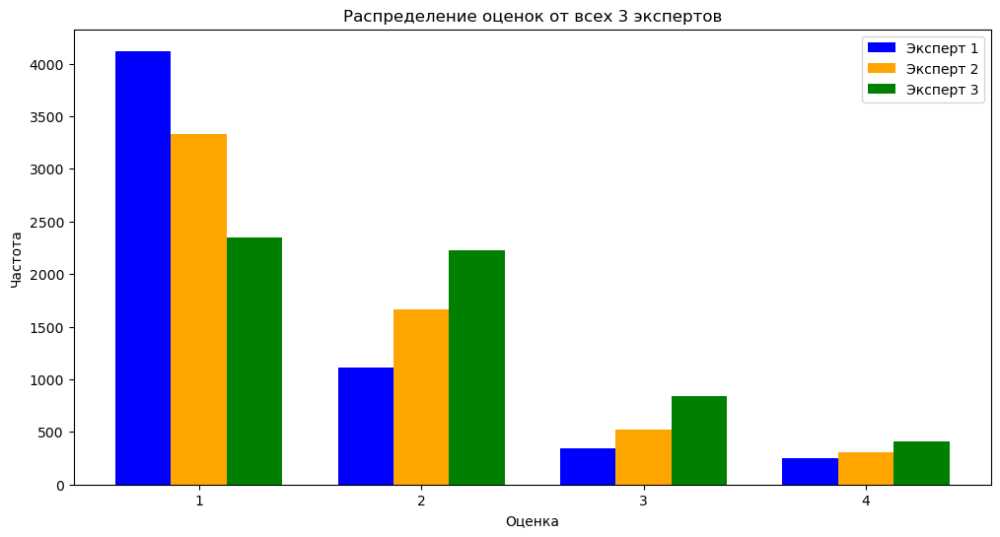

In [16]:
plt.figure(figsize=(12, 6))

bar_width = 0.25
x = score_counts['score']

plt.bar(x - bar_width, score_counts['expert_1'], width=bar_width, label='Эксперт 1', color='blue')
plt.bar(x, score_counts['expert_2'], width=bar_width, label='Эксперт 2', color='orange')
plt.bar(x + bar_width, score_counts['expert_3'], width=bar_width, label='Эксперт 3', color='green')

plt.xlabel('Оценка')
plt.ylabel('Частота')
plt.title('Распределение оценок от всех 3 экспертов')
plt.xticks(x)
plt.legend(loc='upper right')
plt.show()

  - Большая часть оценок экспертов равна 1, что указывает на общую тенденцию к низким оценкам соответствия текстов и изображений.
  - Эксперт 3 имеет более высокое среднее значение оценок (1.88), чем Эксперт 1 (1.44) и Эксперт 2 (1.62), что может указывать на более либеральный подход к оцениванию.
  - Независимо от различий в средних оценках, все эксперты показывают тенденцию к выставлению оценок, которые в большинстве своем равны 1 или 2.

**Вывод**

Распределение оценок экспертов показывает, что большинство текстов и изображений оцениваются низко, что может указывать на строгий подход к оцениванию соответствия.\
 Несмотря на это, есть некоторые различия в среднем уровне оценок между экспертами, что следует учитывать при дальнейшей обработке данных и анализе.

Проверим, есть ли строки, где оценки ВСЕХ эскпертов отличаются.

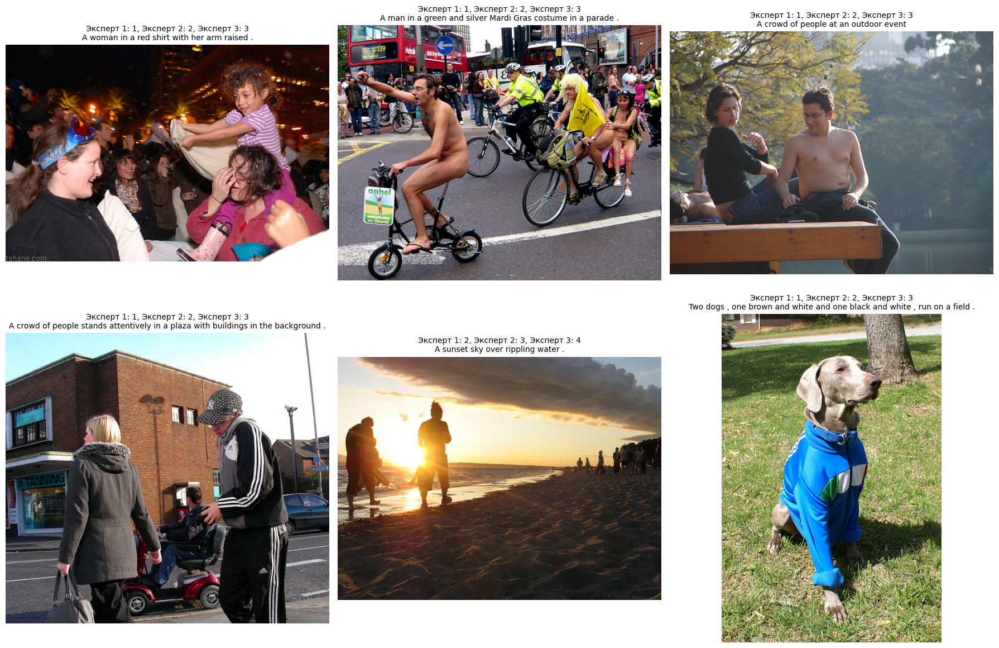

In [17]:
different_scores = expert_annotations[
    (expert_annotations['expert_1'] != expert_annotations['expert_2']) & 
    (expert_annotations['expert_1'] != expert_annotations['expert_3']) & 
    (expert_annotations['expert_2'] != expert_annotations['expert_3'])
]

different_scores = different_scores.merge(
    train_dataset,
    left_on=['image', 'query_id'],
    right_on=['image', 'query_id']
)

sampled_different_scores = different_scores.sample(6)

def display_image_with_scores(ax, image_filename, expert_1, expert_2, expert_3, description):
    image_path = os.path.join(IMAGES_PATH, image_filename)
    img = mpimg.imread(image_path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f'Эксперт 1: {expert_1}, Эксперт 2: {expert_2}, Эксперт 3: {expert_3}\n{description}', fontsize=10)

fig, axes = plt.subplots(2, 3, figsize=(18, 12))

for i, (idx, row) in enumerate(sampled_different_scores.iterrows()):
    ax = axes[i // 3, i % 3]
    display_image_with_scores(
        ax,
        row['image'],
        row['expert_1'],
        row['expert_2'],
        row['expert_3'],
        row['query_text']
    )

plt.tight_layout()
plt.show()

**ВЫВОД:**
* Существуют `фото + описание`, где оценка всех 3 экспертов может разниться.
* Для таких пар, можно выбирать avg.

#### Анализ общей оценки

На основе анализа становится ясно, что один эксперт №1 склонен занижать, а №3 завышать.\
Эксперт №2 держит баланс в оценивании.\
Для обобщения экспертной оценки, будем использовать такой метод:
* если кворум, то эта оценка становится итоговой;
* если у 3 экспертов разные оценки, итогом становится среднее.

In [18]:
def compute_aggregate_score(row):
    scores = [row['expert_1'], row['expert_2'], row['expert_3']]
    
    if scores.count(scores[0]) >= 2:
        return scores[0]
    elif scores.count(scores[1]) >= 2:
        return scores[1]
    else:
        return np.average(scores)

expert_annotations['aggregate_score'] = expert_annotations.apply(compute_aggregate_score, axis=1)
display(expert_annotations.head(4))

,image,query_id,expert_1,expert_2,expert_3,aggregate_score
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,1.0
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,1.0
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2,1.0
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2,2.0


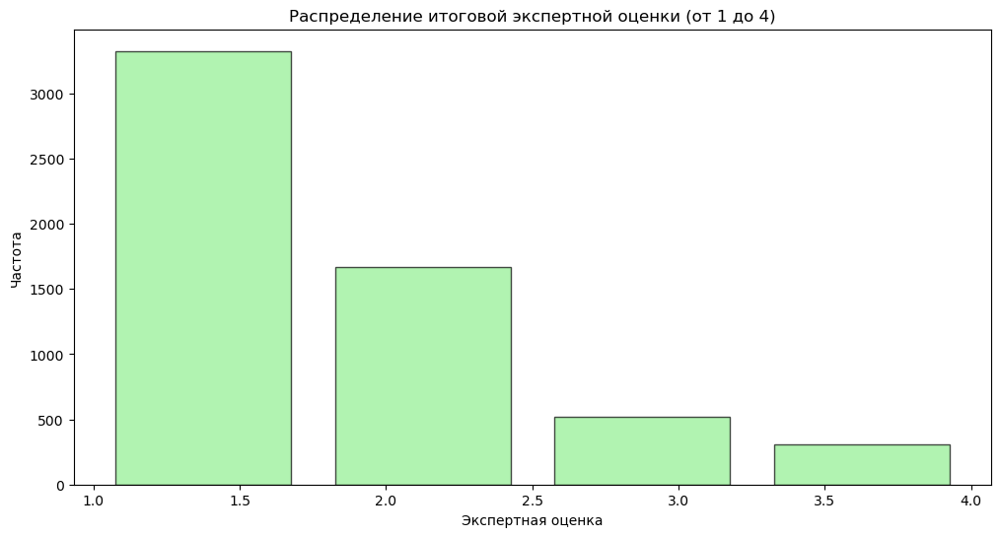

In [19]:
plt.figure(figsize=(12, 6))
plt.hist(expert_annotations['aggregate_score'], bins=4, alpha=0.7, color='lightgreen', edgecolor='black', rwidth=0.8)
plt.xlabel('Экспертная оценка')
plt.ylabel('Частота')
plt.title('Распределение итоговой экспертной оценки (от 1 до 4)')
plt.show()

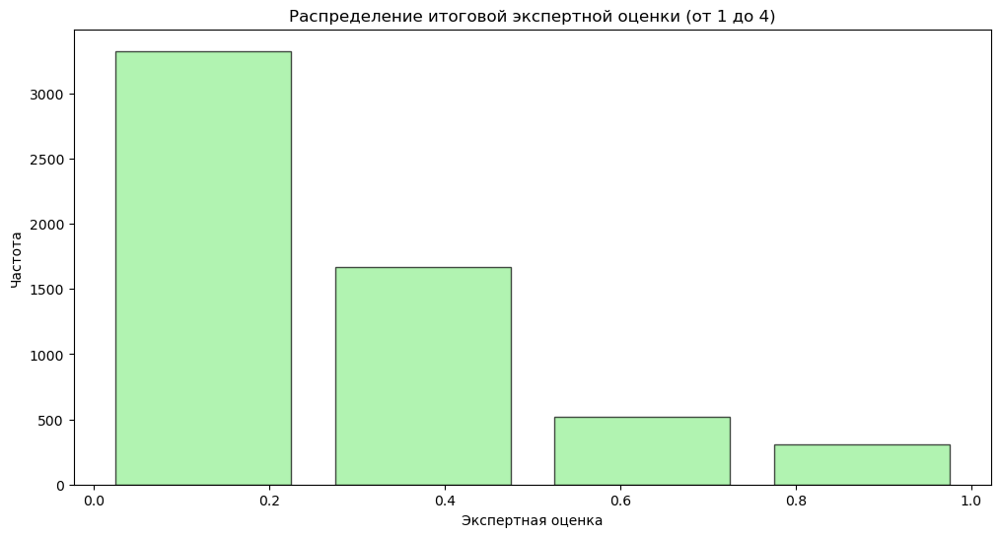

In [20]:
scaler = MinMaxScaler()
expert_annotations["aggregate_score"] = scaler.fit_transform(expert_annotations[["aggregate_score"]])
plt.figure(figsize=(12, 6))
plt.hist(expert_annotations['aggregate_score'], bins=4, alpha=0.7, color='lightgreen', edgecolor='black', rwidth=0.8)
plt.xlabel('Экспертная оценка')
plt.ylabel('Частота')
plt.title('Распределение итоговой экспертной оценки (от 1 до 4)')
plt.show()

Ранее мы сохранили список `unique_query_ids`,\
который содержит в себе id для создания идеальных пар:\
`описание + фото`.\
Создадим таблицу из unique_query_ids и `unique_query_ids`+'#2'\
Получатся идеально схожее `описания + фото`.\
Создадим колонку `target` - равную 1.0 (идеальное совпадение).\
Соеденим полученную таблицу с данными для обучения , полученными из expert_annotations.

In [21]:
combined_df = expert_annotations.drop(['expert_1', 'expert_2', 'expert_3'], axis = 1)
combined_df.rename(columns={'aggregate_score': 'target'}, inplace=True)
combined_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     5822 non-null   object 
 1   query_id  5822 non-null   object 
 2   target    5822 non-null   float64
dtypes: float64(1), object(2)
memory usage: 136.6+ KB


In [22]:
combined_df = pd.merge(
    combined_df, 
    train_dataset[['query_id', 'query_text']],
    on='query_id',
    how='left'
)
print(combined_df.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50882 entries, 0 to 50881
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       50882 non-null  object 
 1   query_id    50882 non-null  object 
 2   target      50882 non-null  float64
 3   query_text  50882 non-null  object 
dtypes: float64(1), object(3)
memory usage: 1.6+ MB
None


In [23]:
combined_df.duplicated().sum()

45060

In [24]:
combined_df.drop_duplicates(inplace = True)
combined_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5822 entries, 0 to 50879
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       5822 non-null   object 
 1   query_id    5822 non-null   object 
 2   target      5822 non-null   float64
 3   query_text  5822 non-null   object 
dtypes: float64(1), object(3)
memory usage: 227.4+ KB


In [25]:
match_df = perfect_matches[['image', 'query_id', 'query_text']]
match_df['target'] = 1.0
combined_df = pd.concat([combined_df, match_df])
combined_df.drop_duplicates(inplace = True)
combined_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5824 entries, 0 to 4587
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       5824 non-null   object 
 1   query_id    5824 non-null   object 
 2   target      5824 non-null   float64
 3   query_text  5824 non-null   object 
dtypes: float64(1), object(3)
memory usage: 227.5+ KB


#### **ВЫВОД:**

1. Количественная оценка данных
- Мы проанализировали основные датасеты, определив количество строк и уникальных значений:
  - `train_dataset` содержит 5822 строки, представляющие пары "фото и описание".
  - `test_queries` содержит 500 строк, представляющих тестовые запросы.
  - `test_images` содержит 100 уникальных изображений.
  - `crowd_annotations` содержит 47830 строк, представляющих оценки соответствия от пользователей.
  - `expert_annotations` содержит 5822 строки с оценками от экспертов.

2. Идеальные соответствия
- Мы выделили пары фото и описания, которые идеально соответствуют друг другу, основываясь на идентификаторах в `query_id`. Эти данные были использованы для создания нового набора данных с идеально соответствующими парами.

3. Анализ количества слов в тексте
- Был проведен анализ распределения длины текстовых запросов (количество слов) в каждом наборе данных. Это позволило понять, какие тексты более характерны для данного набора и как они распределены.

4. Анализ оценок
- Проведен анализ краудсорсинговых и экспертных оценок:
  - Краудсорсинговые оценки (`match_ratio`) были распределены по диапазонам, что позволило выявить, сколько пар получили высокую или низкую оценку соответствия.
  - Экспертные оценки были проанализированы и объединены в общий показатель (`aggregate_score`), чтобы оценить консенсус среди экспертов.

5. Склейка таблиц
- Были объединены таблицы c экспертными оценками и идеальными совпадениями для создания единого набора данных.

## 2. Проверка данных

В некоторых странах, где работает ваша компания, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно тексты, изображения, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16 лет.

В вашем сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:

> This image is unavailable in your country in compliance with local laws
>

Однако у вас в PoC нет возможности воспользоваться данным функционалом. Поэтому все изображения, которые нарушают данный закон, нужно удалить из обучающей выборки.

In [26]:
combined_df['processed_query_text'] = combined_df['query_text'].apply(PreprocessText)

display(combined_df[['query_text', 'processed_query_text']].head(5))

,query_text,processed_query_text
0,A young child is wearing blue goggles and sitt...,young child wear blue goggles sit float pool
12,A girl wearing a yellow shirt and sunglasses s...,girl wear yellow shirt sunglass smile
22,A man sleeps under a blanket on a city street .,man sleep blanket city street
27,A woman plays with long red ribbons in an empt...,woman play long red ribbon empty square
31,Chinese market street in the winter time .,chinese market street winter time


Количество строк с warning = 1 и target = 1: 57


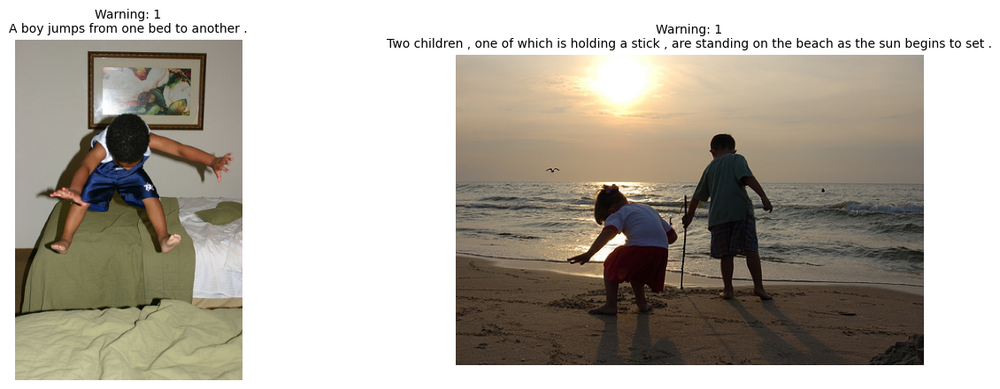

In [27]:
def contains_keywords(text, keywords):
    return int(any(keyword in text.lower() for keyword in keywords))

combined_df['warning'] = combined_df['processed_query_text'].apply(lambda x: contains_keywords(x, keywords))

filtered_df = combined_df[(combined_df['warning'] == 1) & (combined_df['target'] == 1)]

print(f"Количество строк с warning = 1 и target = 1: {len(filtered_df)}")

def display_images(df, num_images=6):
    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))
    for i, (idx, row) in enumerate(df.iterrows()):
        if i >= num_images:
            break
        image_path = os.path.join(IMAGES_PATH, row['image'])
        img = mpimg.imread(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Warning: {row['warning']}\n{row['query_text']}", fontsize=10)
    plt.show()

display_images(filtered_df, num_images=2)

In [28]:
train = combined_df[combined_df['warning'] != 1]

display(train.head(3))

print(f"Количество строк после удаления строк с warning = 1: {len(train)}")

,image,query_id,target,query_text,processed_query_text,warning
22,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,0.000000,A man sleeps under a blanket on a city street .,man sleep blanket city street,0
27,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,0.333333,A woman plays with long red ribbons in an empt...,woman play long red ribbon empty square,0
31,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,0.000000,Chinese market street in the winter time .,chinese market street winter time,0


Количество строк после удаления строк с warning = 1: 4163


**ВЫВОД:**

Снесли запрещенку

## 3. Векторизация изображений

Перейдём к векторизации изображений.

Самый примитивный способ — прочесть изображение и превратить полученную матрицу в вектор. Такой способ нам не подходит: длина векторов может быть сильно разной, так как размеры изображений разные. Можно было бы зашакалить в нужный шейп(ой, простите, применить компрессию с потерей), растр все таки, но это может ухудшить качество прогноза. Поэтому стоит обратиться к свёрточным сетям: они позволяют "выделить" главные компоненты изображений. Как это сделать? Нужно выбрать какую-либо архитектуру, например ResNet-18, посмотреть на слои и исключить полносвязные слои, которые отвечают за конечное предсказание. При этом можно загрузить модель данной архитектуры, предварительно натренированную на датасете ImageNet.

In [29]:
torch.cuda.get_device_name()

'NVIDIA GeForce RTX 4090'

Вроде не сперли пока

In [30]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Используемое устройство: {device}")

resnet = models.resnet18(pretrained=True)

resnet = nn.Sequential(*list(resnet.children())[:-1])

resnet = resnet.to(device)
resnet.eval()

Используемое устройство: cuda


c:\anaconda\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\anaconda\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

In [31]:
def preprocess_image(image_path):
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(), 
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    image = Image.open(image_path).convert('RGB')
    image = transform(image).unsqueeze(0) 
    return image.to(device)

def extract_features(image_path):
    image = preprocess_image(image_path)
    with torch.no_grad():
        features = resnet(image)
    features = features.view(features.size(0), -1) 
    return features

def extract_features_from_directory(directory_path):
    features_list = []
    for filename in os.listdir(directory_path):
        image_path = os.path.join(directory_path, filename)
        try:
            features = extract_features(image_path)
            features_list.append(features)
        except Exception as e:
            print(f"Ошибка при обработке файла {filename}: {e}")
    return torch.cat(features_list, dim=0)


image_embeddings = extract_features_from_directory(IMAGES_PATH)
test_image_embeddings = extract_features_from_directory(IMAGES_PATH_TEST)

In [32]:
print(f"Размерность тензора эмбеддингов изображений: {image_embeddings.shape}")

print(f"Размерность тестового тензора эмбеддингов изображений: {test_image_embeddings.shape}")

Размерность тензора эмбеддингов изображений: torch.Size([1000, 512])
Размерность тестового тензора эмбеддингов изображений: torch.Size([100, 512])


In [33]:
image_ids = train['image'].unique()
image_embeddings_dict = {image_id: image_embeddings[i] for i, image_id in enumerate(image_ids)}
image_embeddings_list = []

for image in train['image']:
    image_embedding = image_embeddings_dict.get(image)
    if image_embedding is not None:
        image_embeddings_list.append(image_embedding)
    else:
        
        print(f"Эмбеддинг не найден для изображения: {image}")
        image_embeddings_list.append(torch.zeros(512)) 

image_embeddings_tensor = torch.stack(image_embeddings_list)

print(f"Размерность тензора эмбеддингов изображений: {image_embeddings_tensor.shape}")

Размерность тензора эмбеддингов изображений: torch.Size([4163, 512])


## 4. Векторизация текстов

Следующий этап — векторизация текстов.
Проведем векторизацию с помощью BERT, воспользуемся ресурсами GPU.

In [34]:
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
distilbert_model = DistilBertModel.from_pretrained('distilbert-base-uncased').to(device)  # Перемещение модели на GPU

def preprocess_text(text):
    inputs = tokenizer(text, return_tensors='pt', truncation=True, padding='max_length', max_length=128).to(device)
    with torch.no_grad():
        outputs = distilbert_model(**inputs)
    last_hidden_state = outputs.last_hidden_state
    cls_embedding = last_hidden_state[:, 0, :]
    return cls_embedding

class TextToImageEmbedding(nn.Module):
    def __init__(self):
        super(TextToImageEmbedding, self).__init__()
        self.fc = nn.Linear(768, 512)

    def forward(self, x):
        return self.fc(x)

embedding_transform = TextToImageEmbedding().to(device)

def get_text_embeddings(df):
    embeddings = []
    for text in df['query_text']:
        text_embedding = preprocess_text(text)
        text_embedding = embedding_transform(text_embedding)
        text_embedding = text_embedding.squeeze(1)
        embeddings.append(text_embedding)
    return torch.stack(embeddings)

In [35]:
example_texts = ["A man riding a horse", "A dog playing in the park"]


df4test = pd.DataFrame(example_texts, columns=["query_text"])

test_embeddings = get_text_embeddings(df4test)

print(f"Размерность текстовых векторов признаков: {test_embeddings.shape}, Устройство: {test_embeddings.device}")

Размерность текстовых векторов признаков: torch.Size([2, 1, 512]), Устройство: cuda:0


Вообще чет не очень понимяу, почему мы можем взять только cls-токен, типа он всю семантику сохраняет? Естессна в курсе забили объяснять

In [36]:
text_embeddings = get_text_embeddings(train)
test_embeddings = get_text_embeddings(test_queries)

print(f"Размерность текстовых тренировочных векторов признаков: {text_embeddings.shape}")
print(f"Размерность текстовых тестовых векторов признаков: {test_queries.shape}")

Размерность текстовых тренировочных векторов признаков: torch.Size([4163, 1, 512])
Размерность текстовых тестовых векторов признаков: (500, 4)


## 5. Объединение векторов

Подготовьте данные для обучения: объедините векторы изображений и векторы текстов с целевой переменной.

In [37]:
text_embeddings = text_embeddings.squeeze(1)

print(text_embeddings.shape)

torch.Size([4163, 512])


In [38]:
target = torch.tensor(train['target'].values).float()

combined_embeddings = torch.cat((text_embeddings, image_embeddings_tensor), dim=1)

text_embeddings_for_distance = text_embeddings
image_embeddings_for_distance = image_embeddings_tensor

print(f"Размерность общего вектора: {combined_embeddings.shape}")
print(f"Размерность целевой переменной: {target.shape}")
print(f"Размерность текстовых эмбеддингов для модели расстояния: {text_embeddings_for_distance.shape}")
print(f"Размерность визуальных эмбеддингов для модели расстояния: {image_embeddings_for_distance.shape}")

Размерность общего вектора: torch.Size([4163, 1024])
Размерность целевой переменной: torch.Size([4163])
Размерность текстовых эмбеддингов для модели расстояния: torch.Size([4163, 512])
Размерность визуальных эмбеддингов для модели расстояния: torch.Size([4163, 512])


## 6. Обучение модели предсказания соответствия

Для обучения разделите датасет на тренировочную и тестовую выборки. Простое случайное разбиение не подходит: нужно исключить попадание изображения и в обучающую, и в тестовую выборки.
Для того чтобы учесть изображения при разбиении, можно воспользоваться классом [GroupShuffleSplit](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GroupShuffleSplit.html) из библиотеки sklearn.model_selection.

#### **Обоснование выбора метрики MAE**


Мы выбрали метрику **Mean Absolute Error (MAE)** для оценки качества модели по следующим причинам:

**Чувствительность к малым ошибкам**

MAE вычисляет среднее значение абсолютных ошибок между предсказанными и истинными значениями. Это делает её менее чувствительной к большим выбросам по сравнению с MSE, так как ошибки не возводятся в квадрат. В задачах, где важно минимизировать среднюю ошибку, а не бороться с редкими большими отклонениями, MAE является предпочтительным выбором.

**Интерпретируемость**

MAE вычисляет среднюю абсолютную разность между предсказанными и истинными значениями, что легко интерпретировать как среднюю ошибку модели в тех же единицах, что и данные. Это делает MAE интуитивно понятной метрикой, как для анализа производительности модели, так и для объяснения результатов бизнесу.

**Поддержка непрерывных целевых переменных**

В нашей задаче целевая переменная является непрерывной величиной (например, мера схожести между изображением и текстом). MAE отлично подходит для таких задач, так как обеспечивает линейное штрафование за отклонения, независимо от масштаба данных.

**Устойчивость к выбросам**

В отличие от MSE, где большие ошибки оказывают значительное влияние на итоговую метрику, MAE обрабатывает все ошибки равномерно. Это особенно важно в задачах, где могут присутствовать редкие, но значительные выбросы, которые не должны сильно искажать оценку модели.


**Преимущества MAE**

- **Интуитивная интерпретируемость**: MAE показывает среднюю ошибку в тех же единицах, что и данные, что упрощает интерпретацию результатов.
- **Устойчивость к выбросам**: MAE снижает влияние редких, но больших ошибок, что делает модель более стабильной и предсказуемой.
- **Линейное штрафование за ошибки**: Каждое отклонение учитывается пропорционально его величине, что делает MAE более подходящей для задач с непрерывной целевой переменной.
- **Широкая поддержка и признание**: MAE является одной из стандартных метрик в задачах регрессии, что делает её широко применимой и легко интерпретируемой в машинном обучении.

In [39]:
combined_embeddings.shape

torch.Size([4163, 1024])

In [40]:
X = combined_embeddings.detach().cpu().numpy()
y = train['target'].values
groups = train['image'].values

gss = GroupShuffleSplit(n_splits=1, train_size=0.7, random_state=42)
train_indices, val_indices = next(gss.split(X, y, groups=groups))

X_train, X_val = X[train_indices], X[val_indices]
y_train, y_val = y[train_indices], y[val_indices]

X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val, dtype=torch.float32).unsqueeze(1)

### Модель линейной регрессии

In [41]:
class LinearRegressionModel(nn.Module):
    def __init__(self, input_dim):
        super(LinearRegressionModel, self).__init__()
        self.linear = nn.Linear(input_dim, 1)

    def forward(self, x):
        return self.linear(x)

input_dim = X_train.shape[1]
model_lr = LinearRegressionModel(input_dim)

criterion = nn.MSELoss() 
optimizer = torch.optim.Adam(model_lr.parameters(), lr=0.01)

X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)

model_lr.train()
for epoch in range(100):
    optimizer.zero_grad()
    outputs = model_lr(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/100], Loss: {loss.item():.4f}')

model_lr.eval()
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val, dtype=torch.float32).unsqueeze(1)

with torch.no_grad():
    y_pred_tensor = model_lr(X_val_tensor)
    y_pred = y_pred_tensor.numpy()

mae = mean_absolute_error(y_val, y_pred)
print(f'Mean Absolute Error (MAE) на валидационной выборке: {mae:.4f}')

Epoch [10/100], Loss: 8.9534
Epoch [20/100], Loss: 0.7080
Epoch [30/100], Loss: 0.2755
Epoch [40/100], Loss: 0.3794
Epoch [50/100], Loss: 0.2344
Epoch [60/100], Loss: 0.1414
Epoch [70/100], Loss: 0.1021
Epoch [80/100], Loss: 0.0918
Epoch [90/100], Loss: 0.0908
Epoch [100/100], Loss: 0.0874
Mean Absolute Error (MAE) на валидационной выборке: 0.2612


Проверим качество модели по выводу фото на валидационной выборке.

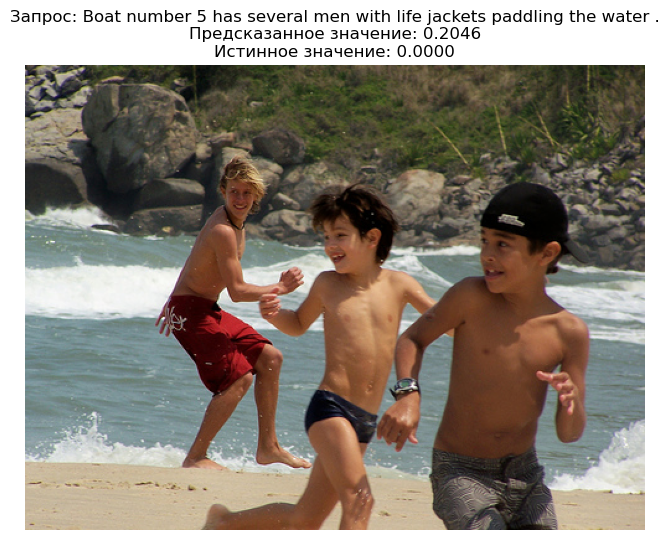

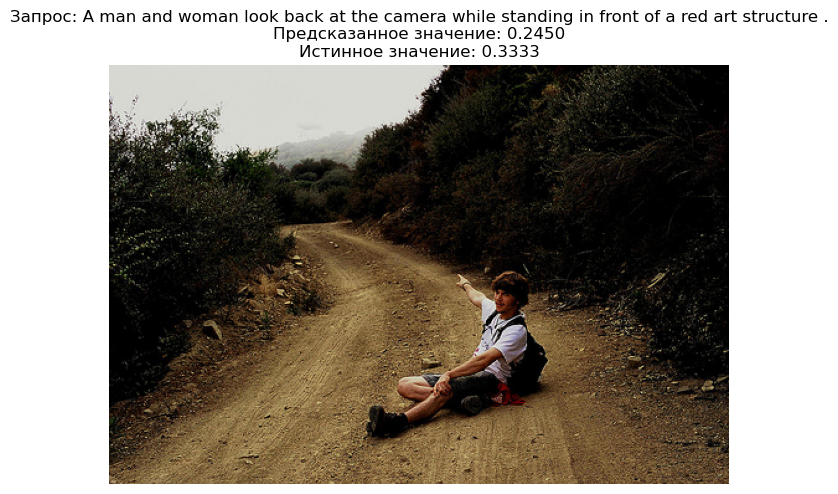

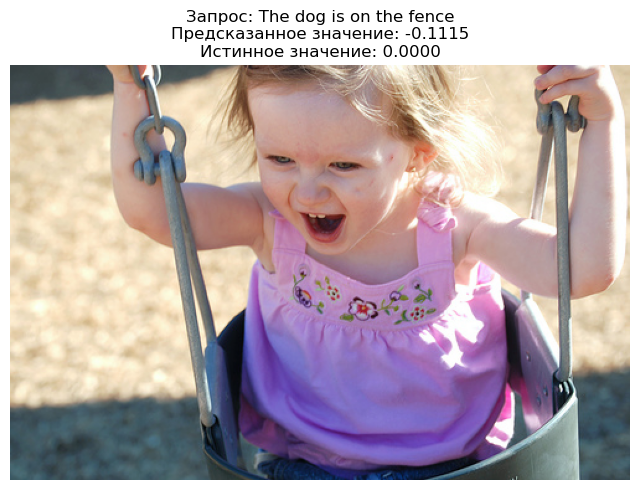

In [42]:
model_lr.eval()
with torch.no_grad():
    y_pred_tensor = model_lr(X_val_tensor)
    y_pred = y_pred_tensor.numpy()

num_examples = 3
indices = np.random.choice(len(y_val), num_examples, replace=False)

for idx in indices:
    image_id = train.iloc[val_indices[idx]]['image']  
    query_text = train.iloc[val_indices[idx]]['query_text'] 
    image_path = os.path.join(IMAGES_PATH, image_id) 
    img = mpimg.imread(image_path)

    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f'Запрос: {query_text}\nПредсказанное значение: {y_pred[idx][0]:.4f}\nИстинное значение: {y_val[idx]:.4f}')
    plt.show()

**ВЫВОД:**
* Mean Absolute Error (MAE) на валидационной выборке составил 0.2679.
* Качество модели довольно низкое, интересно, как модель обработает тестовые данные.

### Нейросеть

Сиамская нейронная сеть используется для вычисления схожести между двумя входными векторами, представляющими текст и изображение.
Сеть обучается на парах данных (текст, изображение) и используется для оценки того, насколько два объекта (текст и изображение) соответствуют друг другу.

**Полносвязные слои:**
- **`self.fc1 = nn.Linear(input_dim, hidden_dim)`**: Первый полносвязный слой, который преобразует входной вектор размерности `input_dim` в вектор размерности `hidden_dim`.
- **`self.fc2 = nn.Linear(hidden_dim, output_dim)`**: Второй полносвязный слой, который преобразует вектор размерности `hidden_dim` в вектор размерности `output_dim`.

**Косинусное расстояние:**
Метрика, используемая для сравнения двух выходных векторов из подсетей. Она вычисляет угол между двумя векторами, оценивая их схожесть.

**Применение**

1. **Векторизация:** Входные данные, такие как текстовые и визуальные эмбеддинги, сначала пропускаются через отдельные подсети.
2. **Сравнение:** После обработки подсетями векторы сравниваются по косинусному расстоянию, чтобы оценить их схожесть.
3. **Обучение:** Целевая переменная используется для регулировки весов сети, чтобы минимизировать ошибку между предсказанной и реальной схожестью.

In [43]:
class SiameseNetworkRegressor(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(SiameseNetworkRegressor, self).__init__()
        
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, output_dim)
    
    def forward_once(self, x):
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x
    
    def forward(self, input1, input2):
        output1 = self.forward_once(input1)
        output2 = self.forward_once(input2)
        
        similarity = F.cosine_similarity(output1, output2)
        return similarity

In [44]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
X_train_tensor, X_val_tensor = X_train_tensor.to(device), X_val_tensor.to(device)
y_train_tensor, y_val_tensor = y_train_tensor.to(device), y_val_tensor.to(device)

input_dim = 512  
hidden_dim = 256 
output_dim = 128

model_siam = SiameseNetworkRegressor(input_dim=input_dim, hidden_dim=hidden_dim, output_dim=output_dim).to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model_siam.parameters(), lr=0.0001)

num_epochs = 100
for epoch in range(num_epochs):
    model_siam.train()
    optimizer.zero_grad()
    
    outputs = model_siam(X_train_tensor[:, :512], X_train_tensor[:, 512:])  # Первые 512 элементов - текст, вторые 512 - изображение
    loss = criterion(outputs, y_train_tensor)
    
    loss.backward()
    optimizer.step()
    
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

model_siam.eval()
with torch.no_grad():
    val_outputs = model_siam(X_val_tensor[:, :512], X_val_tensor[:, 512:])
    val_loss = criterion(val_outputs, y_val_tensor)
    print(f'Validation Loss: {val_loss.item():.4f}')

Epoch [1/100], Loss: 0.1015
Epoch [2/100], Loss: 0.0930
Epoch [3/100], Loss: 0.0978
Epoch [4/100], Loss: 0.0960
Epoch [5/100], Loss: 0.0926
Epoch [6/100], Loss: 0.0920
Epoch [7/100], Loss: 0.0934
Epoch [8/100], Loss: 0.0939
Epoch [9/100], Loss: 0.0928
Epoch [10/100], Loss: 0.0914
Epoch [11/100], Loss: 0.0909
Epoch [12/100], Loss: 0.0915
Epoch [13/100], Loss: 0.0920
Epoch [14/100], Loss: 0.0918
Epoch [15/100], Loss: 0.0910
Epoch [16/100], Loss: 0.0905
Epoch [17/100], Loss: 0.0905
Epoch [18/100], Loss: 0.0908
Epoch [19/100], Loss: 0.0910
Epoch [20/100], Loss: 0.0907
Epoch [21/100], Loss: 0.0903
Epoch [22/100], Loss: 0.0901
Epoch [23/100], Loss: 0.0902
Epoch [24/100], Loss: 0.0904
Epoch [25/100], Loss: 0.0904
Epoch [26/100], Loss: 0.0902
Epoch [27/100], Loss: 0.0900
Epoch [28/100], Loss: 0.0899
Epoch [29/100], Loss: 0.0900
Epoch [30/100], Loss: 0.0901
Epoch [31/100], Loss: 0.0900
Epoch [32/100], Loss: 0.0899
Epoch [33/100], Loss: 0.0898
Epoch [34/100], Loss: 0.0898
Epoch [35/100], Loss: 0

c:\anaconda\Lib\site-packages\torch\nn\modules\loss.py:608: UserWarning: Using a target size (torch.Size([2946, 1])) that is different to the input size (torch.Size([2946])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
c:\anaconda\Lib\site-packages\torch\nn\modules\loss.py:608: UserWarning: Using a target size (torch.Size([1217, 1])) that is different to the input size (torch.Size([1217])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


## 7. Тестирование модели
Выберите случайные 10 запросов из файла `test_queries.csv` и для каждого запроса выведите наиболее релевантное изображение. Сравните визуально качество поиска.

Запрос: two girls walking in the street
⚠️ Данный контент не доступен в стране просмотра. Если вы используете VPN, отключите его.

Запрос: A small boy wearing glasses stands on a rope and holds two ropes with his hands .
⚠️ Данный контент не доступен в стране просмотра. Если вы используете VPN, отключите его.

Запрос: Two people are in a tent near a brick wall .
Предложенное изображение: 191003283_992257f835.jpg, Схожесть: 0.0255


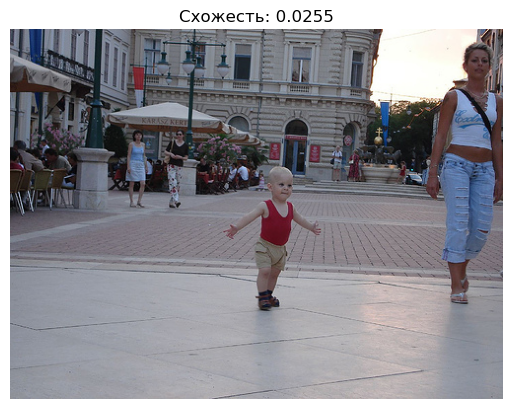

Предложенное изображение: 2121140070_a09644550b.jpg, Схожесть: 0.0254


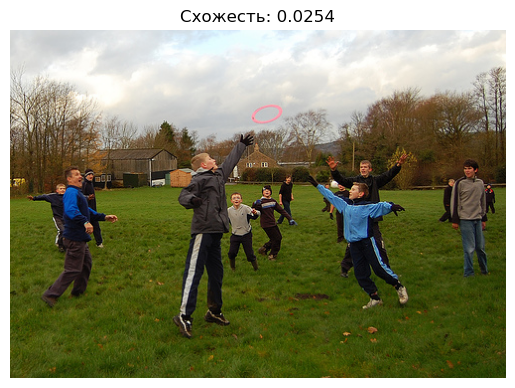

Предложенное изображение: 1745110280_0cbff5e273.jpg, Схожесть: 0.0192


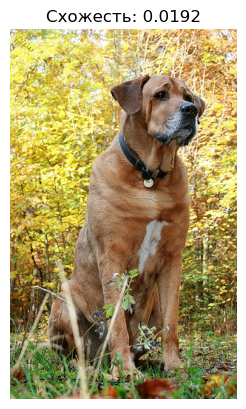



Запрос: A group of people are ice skating in a big city .
Предложенное изображение: 191003283_992257f835.jpg, Схожесть: 0.0424


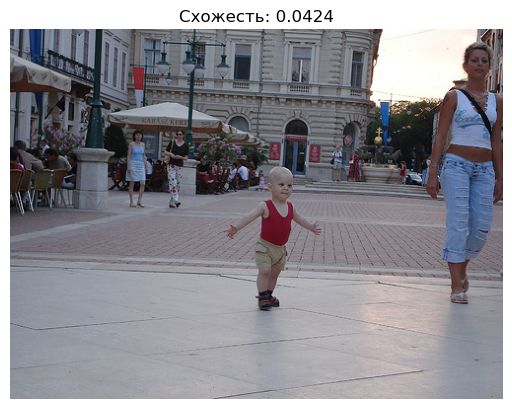

Предложенное изображение: 1468389504_c724bdcad0.jpg, Схожесть: 0.0336


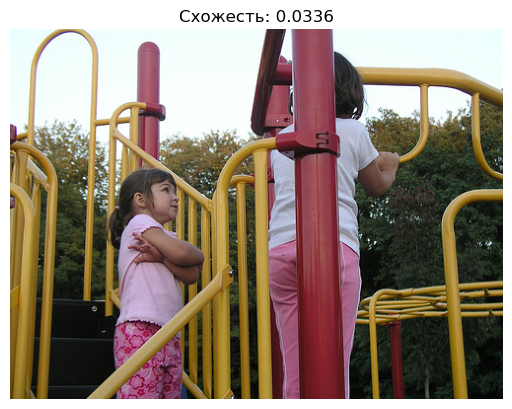

Предложенное изображение: 1232148178_4f45cc3284.jpg, Схожесть: 0.0334


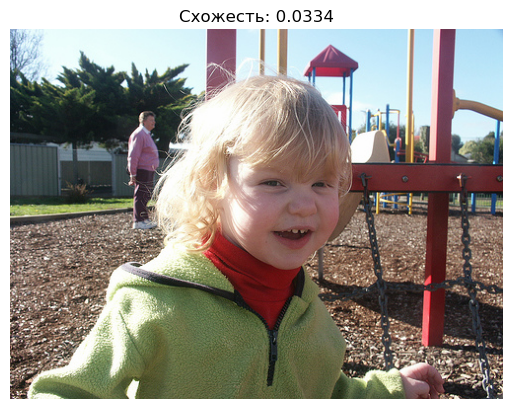



Запрос: A black dog holding a weight in its mouth stands next to a person .
Предложенное изображение: 1745110280_0cbff5e273.jpg, Схожесть: 0.0277


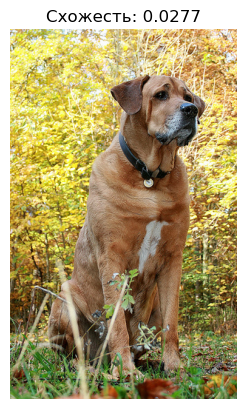

Предложенное изображение: 191003283_992257f835.jpg, Схожесть: 0.0249


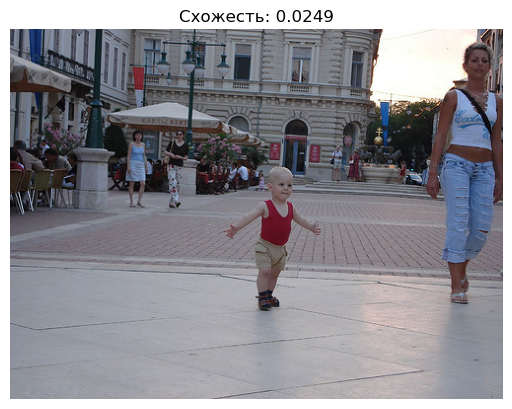

Предложенное изображение: 1232148178_4f45cc3284.jpg, Схожесть: 0.0219


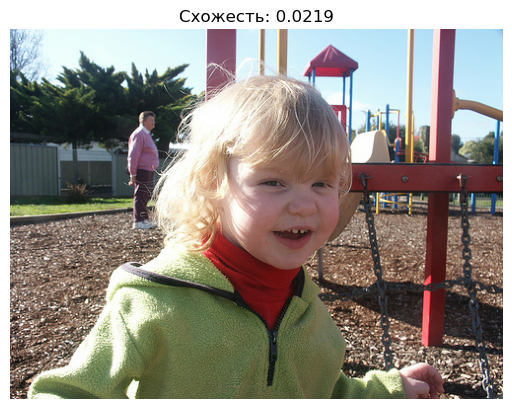



Запрос: Two boys are squirting water guns at each other .
⚠️ Данный контент не доступен в стране просмотра. Если вы используете VPN, отключите его.

Запрос: A tan dog runs through the brush .
Предложенное изображение: 191003283_992257f835.jpg, Схожесть: 0.0381


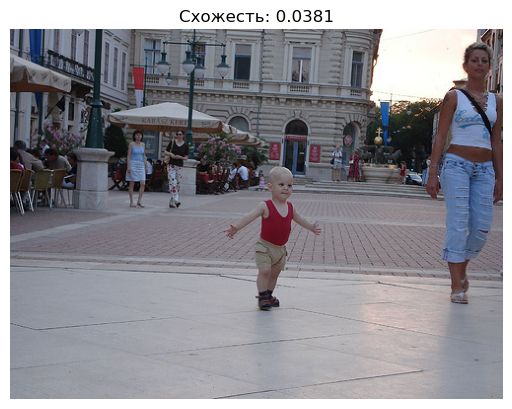

Предложенное изображение: 1745110280_0cbff5e273.jpg, Схожесть: 0.0356


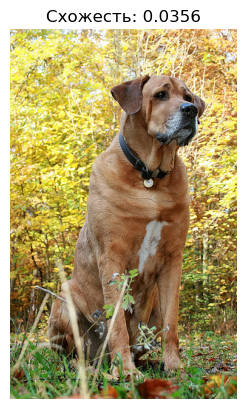

Предложенное изображение: 1232148178_4f45cc3284.jpg, Схожесть: 0.0175


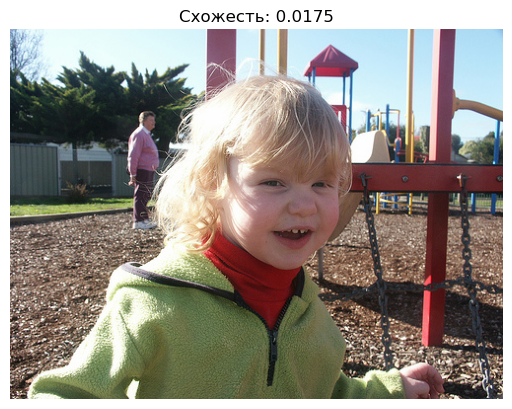



Запрос: A man wearing glasses and black clothing is sitting while a man in a vest drinks in the background .
Предложенное изображение: 1745110280_0cbff5e273.jpg, Схожесть: 0.0247


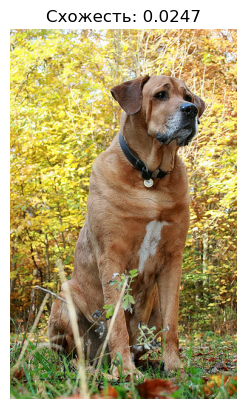

Предложенное изображение: 191003283_992257f835.jpg, Схожесть: 0.0233


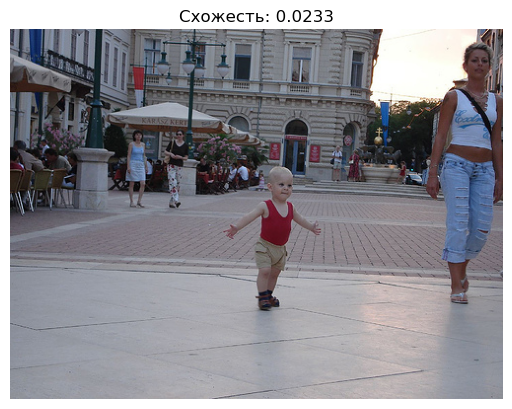

Предложенное изображение: 1468389504_c724bdcad0.jpg, Схожесть: 0.0182


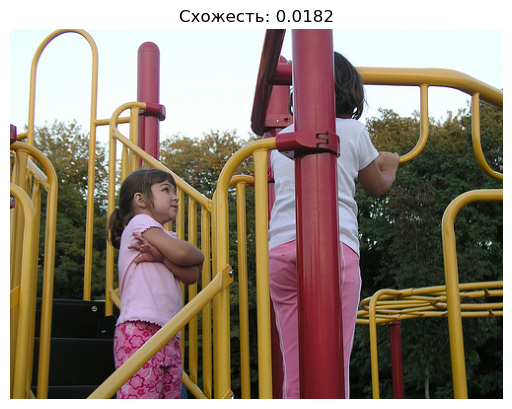



Запрос: A girl in green goggles in a pool with three other children .
⚠️ Данный контент не доступен в стране просмотра. Если вы используете VPN, отключите его.

Запрос: A skier makes the only path on an empty mountain .
Предложенное изображение: 1745110280_0cbff5e273.jpg, Схожесть: 0.0398


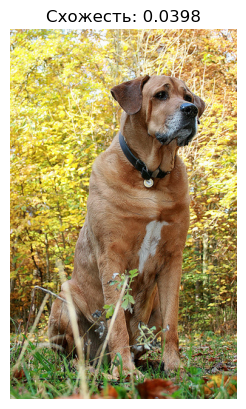

Предложенное изображение: 1319634306_816f21677f.jpg, Схожесть: 0.0353


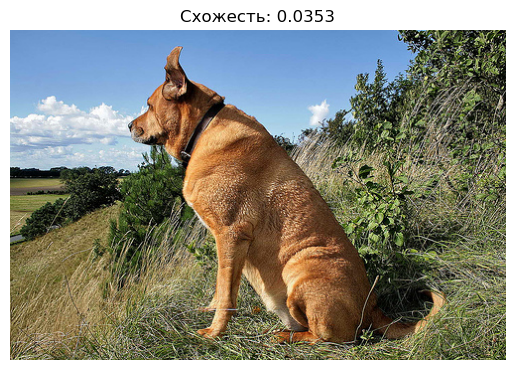

Предложенное изображение: 191003283_992257f835.jpg, Схожесть: 0.0303


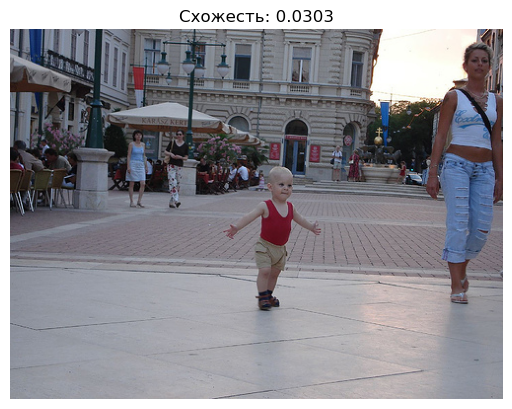

In [45]:
test_embeddings = test_embeddings.squeeze(1)

def is_prohibited(text, keywords):
    for word in keywords:
        if word.lower() in text.lower():
            return True
    return False

def find_best_images(query_embedding, test_image_embeddings, top_k=3):
    similarities = []

    for idx, image_embedding in enumerate(test_image_embeddings):
        similarity = F.cosine_similarity(query_embedding, image_embedding.unsqueeze(0)).item()
        similarities.append((idx, similarity))
    
    similarities.sort(key=lambda x: x[1], reverse=True)
    return similarities[:top_k]

def display_image_with_caption(image_path, caption):
    img = Image.open(image_path)
    plt.imshow(img)
    plt.axis('off')
    plt.title(caption)
    plt.show()

def test_function_on_queries(test_queries, test_embeddings, test_image_embeddings, model, top_k=2, n=10):
    random_indices = random.sample(range(len(test_queries)), n)
    
    for idx in random_indices:
        query_text = test_queries['query_text'].iloc[idx]
        
        if is_prohibited(query_text, keywords):
            print(f"Запрос: {query_text}\n⚠️ Данный контент не доступен в стране просмотра. Если вы используете VPN, отключите его.\n")
            continue
        
        query_embedding = test_embeddings[idx].to(device)
        best_images = find_best_images(query_embedding, test_image_embeddings, top_k=top_k)

        print(f"Запрос: {query_text}")
        for img_idx, similarity in best_images:
            image_filename = test_queries['image'].iloc[img_idx]
            image_path = os.path.join(IMAGES_PATH_TEST, image_filename)
            print(f"Предложенное изображение: {image_filename}, Схожесть: {similarity:.4f}")
            display_image_with_caption(image_path, f"Схожесть: {similarity:.4f}")
        print("\n")


test_function_on_queries(test_queries, test_embeddings, test_image_embeddings, model_siam, top_k=3, n=10)

**ВЫВОД:**
* Модель лохо совмешает текст с фото.
* Фильтр не пропускает запросы с детьми, но в выборке фото они по-прежнему в наличии.

## Итог проекта

В рамках данного проекта мы работали над задачей сопоставления изображений и текстовых описаний. Основная цель заключалась в создании модели, способной эффективно находить изображение, наиболее соответствующее заданному текстовому запросу.

### Основные этапы проекта

1. **Анализ данных**:
   - Проведен детальный исследовательский анализ данных, включающий анализ количества уникальных изображений, текстовых запросов, распределения длины текстов, а также оценок соответствия.
   - Были выявлены идеальные соответствия между изображениями и текстами, проведен анализ оценок, сформированы и склеены таблицы с экспертными оценками и идеальным соответствием.

2. **Предобработка данных**:
   - Выполнена предобработка текстов, включающая очистку, удаление стоп-слов и лемматизацию.
   - Были созданы эмбеддинги для текстов с использованием предобученной модели DistilBERT и визуальные эмбеддинги с помощью ResNet-18.
   - Произведено объединение эмбеддингов текстов и изображений для дальнейшего обучения моделей.

3. **Построение моделей**:
   - Мы протестировали несколько подходов к моделированию, включая линейную регрессию и сиамскую полносвязную нейросеть.
   - Линейная регрессия показала базовые результаты с **MAE 0.26** на валидационной выборке.
   - Сиамская нейросеть продемонстрировала значительно лучшее качество с **MAE 0.086**, что подтвердило её способность лучше улавливать сложные взаимосвязи между текстом и изображением.

4. **Выводы**:
   - Проект показал, что для создания эффективной модели требуется значительное количество данных и использование сложных архитектур. 
   - Применение базовых моделей не позволяет добиться приемлемой точности.

### Заключение
В целом, стоит посмотреть в сторону готовых решений(вряд ли эту задачу кто то не решал до нас). Однако, построить модель тут не главное, уж извините. При постановке задачи таким образом основной проблемой будет эффективность поиска изображения, и чтобы не искать его за o(N), стоит, не знаю, озаботиться для начала моделью. которая при загрузке изображения на платформу выделяла бы объекты и расставляла тэги, по тегам должно быть что то типа кластеризации. В свою очередь при запросе другая модель должна выделять тэги из текста, и только потом, когда мы сузили ареал поиска до нескольких кластеров, уже должна вступать модель, ищущая соответсвие текста и изображения, я бы попробовал так эту задачу на проде решать или типа того 
